In [80]:
import pandas as pd
import numpy as np
import string
from nltk import word_tokenize
import nltk
from nltk.probability import FreqDist
from nltk.corpus import stopwords
import pymorphy2
import re
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from multiprocessing import Process
import os
import shutil
import time

In [2]:
morph = pymorphy2.MorphAnalyzer()

In [5]:
df = pd.read_csv('habr_dataset.csv')

# Очистка текста

In [13]:
def del_names(text):
    names = re.findall('[А-Я][а-я*]+', text)
    # print(names)
    filtered_names = []
    for i in names:
        if '*' in i:
            filtered_names.append(i)

        else:
            type_ = str(morph.parse(i)[0].tag)
            # print(type_)
            for j in ['Name', 'Surn', 'Patr']:
                if j in type_:
                    filtered_names.append(i)
                    break
       

    # print(filtered_names)
    for i in filtered_names:
        text = text.replace(i, '')

    return text

In [14]:
del_names('лабораторию Чарльза Фрэнсиса Дженкинса, изобретателя,  в журнале Works in Progress.')

'лабораторию   , изобретателя,  в журнале Works in Progress.'

In [15]:
def lemmatizer(text):
    text = text.split()
    new_text = []

    for i in text:
        tmp = morph.parse(i)[0]
        new_text.append(tmp.normal_form)
    
    return ' '.join(new_text)

In [16]:
lemmatizer('не обращали внимания на алмазную промышленность')

'не обращать внимание на алмазный промышленность'

In [21]:
punctuation = string.punctuation + '«»\t—…’–№\xa0\n'

def replace_punctuation(text):
    for i in punctuation:
        text = text.replace(i, ' ')
    return text

In [23]:
replace_punctuation('бриллиантов.В эпоху, когда\nИ')

'бриллиантов В эпоху  когда И'

In [25]:
def clear_text(row):
    text = row['text']

    text = re.sub('((www\.[^\s]+)|(https?://[^\s]+))', 'URL', text) # Удаляем ссылки
    text = del_names(text) # Удаляем имена
    text = text.lower().replace("ё", "е") 
    text = replace_punctuation(text) # Удаляем пунктуацию

    symbols = re.findall("[A-Za-zА-Яа-я\s]", text) # Оставляем только буквы и пробельные символы
    text = ''.join(symbols)
    
    text = re.sub(' +', ' ', text) # Заменяем несколько пробелов на 1
    text = lemmatizer(text) # Приводим слова к нормальной форме
    row['text'] = text.strip()
    return row

In [29]:
df[:1]['text'].values, df[:1].apply(clear_text, axis=1)['text'].values

(array(['Производство бриллиантов стало дешевле, чем когда-либо, что создаёт странную проблему: слишком много бриллиантов.В эпоху, когда в Интернете можно купить практически всё, что угодно, нет ничего удивительного в том, что на китайском сайте электронной коммерции Alibaba можно приобрести станок для изготовления бриллиантов за $200 000. Если вы, как и я, не обращали внимания на алмазную промышленность, то окажется, что доступность этих машин отражает постоянную тенденцию к демократизации производства алмазов — процесс, начавшийся несколько десятилетий назад и продолжающий развиваться. Изображение станка для производства синтетических алмазов HPHT Cubic Press, изготовленного компанией Henan Huanghe Whirlwind Co., Ltd. в Китае.История бриллиантов, выращенных в лаборатории, насчитывает не менее полувека. По словам аспиранта Гарварда Джавида Лакха (Javid Lakha), написавшего обширную статью о выращенных в лаборатории алмазах, опубликованную в журнале Works in Progress в прошлом месяце, п

## Обработка всех текстов

In [62]:
dir_name = '.ds_tmp'

In [66]:
def devide_texts(df, parts = 5):
    l = len(df)//parts
    data = []
    amount = 0
    
    for i in range(parts):
        if i + 1 == parts:
            data.append(df[i*l:-1])
        else:
            data.append(df[i*l:(i+1)*l])
            
        # print(len(data[i]), i*l, (i+1)*l)
        amount+=len(data[i])
    
    print('Amount:', amount)
    for i, value in enumerate(data, start = 1):
       print(f'Part {i}, data len: {len(value)}')

    return data

In [72]:
data = devide_texts(df)

Amount: 4337
Part 1, data len: 867
Part 2, data len: 867
Part 3, data len: 867
Part 4, data len: 867
Part 5, data len: 869


In [73]:
data[0][:3]

,url,title,theme,tags,read_time,number_of_views,date,amount_of_imgs,comments,bookmark,votes,text
0,https://habr.com/ru/articles/842474/,На Alibaba можно купить станок для изготовлени...,Научно-популярное,"['Научно-популярное', 'Физика']",4,2800,2024-09-11 14:58:00,0,4,3,0,"Производство бриллиантов стало дешевле, чем ко..."
1,https://habr.com/ru/articles/842336/,"Учёные, искавшие жизнь на Марсе, услышали сигн...",Научно-популярное,"['Научно-популярное', 'Астрономия']",8,1600,2024-09-11 13:38:00,0,1,2,0,"В 1924 году радиоприёмник, созданный для полей..."
2,https://habr.com/ru/companies/montirey/article...,Проявление свойств эфира: доказано эксперимент...,Блог компании Мон Тирэй,"['Блог компании Мон Тирэй', 'Научно-популярное...",7,3700,2024-09-11 11:24:00,0,44,5,0,Исследования российских учёных подтвердили сущ...


In [64]:
def worker(i, data):
    text = data.apply(clear_text, axis=1)
    text.to_csv(f'{dir_name}/clean_text_{i}.csv')

In [75]:
def join_results(parts = 5):
    data = []

    for i in range(parts):
        data.append(pd.read_csv(f'{dir_name}/clean_text_{i}.csv', index_col=0))
    
    return pd.concat(data)

In [99]:
def preprocess(data, num_workers = 5, ds_name='clean_text.csv'):
    thread_list = []

    os.mkdir(dir_name)
    start_time = time.time()

    for i in range(num_workers):
        thread_list.append(Process(target=worker, args=(i, data[i])))
        thread_list[i].start()

    for i in range(num_workers):
        thread_list[i].join()

    df = join_results()
    df.to_csv(ds_name)
    
    end_time = time.time()
    print(f'Elapsed time: {end_time-start_time} sec')
    print(f'Saved to {ds_name}')
    shutil.rmtree(dir_name)

### Test

In [77]:
data = devide_texts(df[:11])

Amount: 10
Part 1, data len: 2
Part 2, data len: 2
Part 3, data len: 2
Part 4, data len: 2
Part 5, data len: 2


In [100]:
preprocess(data, ds_name='test_clean_text.csv')

Elapsed time: 1.4212210178375244 sec
Saved to clean_text.csv


In [101]:
pd.read_csv('clean_text.csv')['text'].values[7]

'привет хабра это из мтс диджитал сегодня поговорить про золото в природный условие этот металл редко вступать в химический реакция человек извлекать он из вмещать порода часть добыть золото самородок но как они образоваться глубоко под земля один из возможный объяснение связать с землетрясение и электричество подробно о это с пример и пруфами под кат пьезоэлектрический эффект и золотой залежь всё начинаться с пьезоэлектрический эффект который образоваться в время землетрясение это эффект возникновение поляризация диэлектрик под действие механический напряжение прямой пьезоэлектрический эффект то есть под давление который возникать в время землетрясение некоторый минерал начинать генерировать электрический заряд пример кварц австралийский учёный предположить что именно этот процесс способствовать накопление золото электричество запускать физико химический реакция приводить к осаждение золото из окружающий раствор гипотеза выглядеть реалистичный с она помощь можно объяснить как образова

### On actual data

In [102]:
data = devide_texts(df)
preprocess(data)

Amount: 4337
Part 1, data len: 867
Part 2, data len: 867
Part 3, data len: 867
Part 4, data len: 867
Part 5, data len: 869
Elapsed time: 329.64770340919495 sec
Saved to clean_text.csv


In [106]:
df1 = pd.read_csv('clean_text.csv', index_col=0)
df1['text']

0       производство бриллиант стать дешёвый чем когда...
1       в год радиоприёмник создать для поле сражение ...
2       исследование российский учёный подтвердить сущ...
3       создатель точнее весь описывать ритча именно э...
4       поиск лекарство от болезнь альцгеймер становит...
                              ...                        
4332    источник интернет вещь это не только резко поу...
4333    мы воспринимать окружающий мир посредством наб...
4334    альфа южный рыба увидеть фомальгаут в москва э...
4335    минуточка внимание как то так получаться что т...
4336    статья посвятить многий неизвестный тип радиол...
Name: text, Length: 4337, dtype: object

# Частотность слов по темам

In [113]:
x = df.groupby('theme').count()
x = x.sort_values(by='url', ascending = False)[:8]

themes = x['url'].index
x['url']

theme
Научно-популярное                   1388
Блог компании RUVDS.com              338
Блог компании ua-hosting.company     280
Блог компании FirstVDS               218
Читальный зал                        196
Блог компании Timeweb Cloud          194
Математика*                          120
Блог компании Онлайн Патент          109
Name: url, dtype: int64

In [133]:
stop_list = stopwords.words("russian")
stop_list.extend(['это', 'который', 'всё', 'весь', 'свой', 'наш', 'ещё', 'также', 'год', 'c', 'е', 'с', 'e', 'b', 'a', 'gb', 'd'])

In [122]:
def display_word_freq(theme, fdist):
    print(theme)
    common = fdist.most_common(15)
    words = [i[0] for i in common]
    amount = [i[1] for i in common]
    tmp_df = pd.DataFrame({'Word': words, 'Amount': amount})
    print(tmp_df)
    print('---'*25, '\n'*3)

In [138]:
freq_items = {}

for i in themes:
    texts = ' '.join(df1[df1['theme'] == i]['text'])
    text_tokens = word_tokenize(texts)
    text_tokens = [token.strip() for token in text_tokens if token not in stop_list]
    text = nltk.Text(text_tokens)
    fdist = FreqDist(text)

    freq_items[i] = [i[0] for i in fdist.most_common(100)]
    
    display_word_freq(i, fdist)

Научно-популярное
        Word  Amount
0       мочь   13857
1      время    7771
2    человек    6271
3     звезда    6268
4    система    5534
5    большой    4741
6     первый    4433
7    энергия    4162
8      новый    4070
9      земля    3683
10   планета    3668
11     очень    3641
12     иметь    3604
13  являться    3541
14     самый    3499
--------------------------------------------------------------------------- 



Блог компании RUVDS.com
         Word  Amount
0        мочь    2713
1       время    2114
2       стать    1603
3     человек    1565
4      первый    1361
5     большой    1336
6       самый    1152
7     система    1146
8       новый    1129
9       очень    1123
10      иметь    1026
11      часть    1012
12     работа     923
13  вселенная     857
14     именно     847
--------------------------------------------------------------------------- 



Блог компании ua-hosting.company
            Word  Amount
0         учёный    3882
1           мочь    3205
2 

In [137]:
def draw_text_cloud(tokens):
    text_raw = " ".join(tokens)
    print(text_raw)
    wordcloud = WordCloud(width=1600, height=800,
                          background_color='white', colormap='magma')
    wordcloud.generate(text_raw)
    plt.figure(figsize=(20,10), facecolor='w')
    plt.imshow(wordcloud)
    plt.show()

Theme: Научно-популярное
мочь время человек звезда система большой первый энергия новый земля планета очень иметь являться самый работа скорость вселенная часть мир результат должный стать квантовый частица галактика исследование использовать жизнь несколько объект вода больший процесс каждый космический масса некоторый получить друг случай находиться например говорить вид именно свет поэтому теория состояние учёный количество существовать работать проблема однако модель просто пространство хороший дать волна сделать чёрный точка вопрос высокий мозг информация помощь солнечный разный уровень м место статья клетка солнце температура обнаружить момент образ любой луна происходить дыра расстояние материя около день рис поверхность измерение знать сказать сторона газ маленький орбита эксперимент


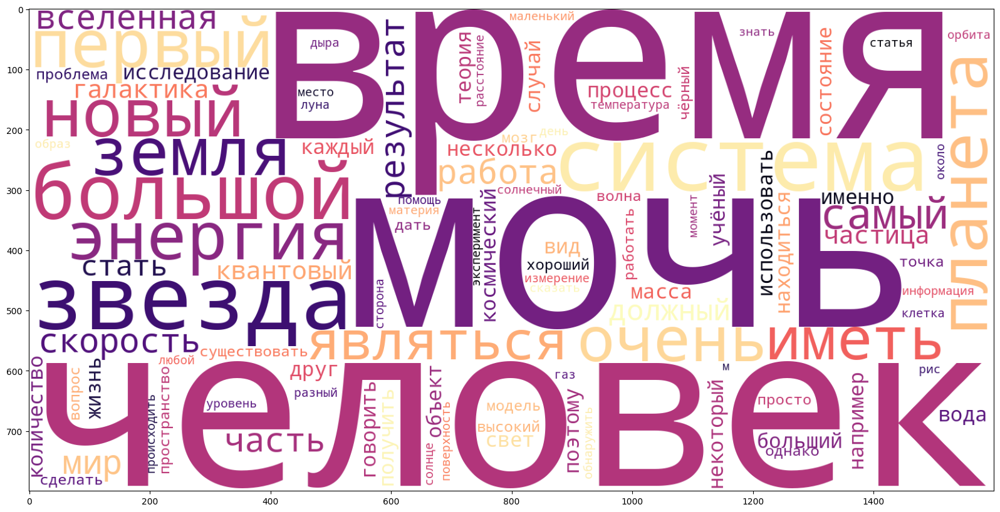

Theme: Блог компании RUVDS.com
мочь время стать человек первый большой самый система новый очень иметь часть работа вселенная именно энергия являться использовать модель несколько просто некоторый больший каждый например случай жизнь вид работать г должный результат однако дело поэтому разный хороший х ток число получить место мир масса проблема вода друг игра сша сделать образ высокий земля уровень количество конец общий пространство процесс начало хотя любой говорить форма момент объект находиться напряжение теория слово проект устройство скорость космический история город знать помощь дать вопрос делать оказаться аккумулятор существовать сила второй сторона день статья пока источник страна лишь происходить свет компания планета качество эксперимент возможность


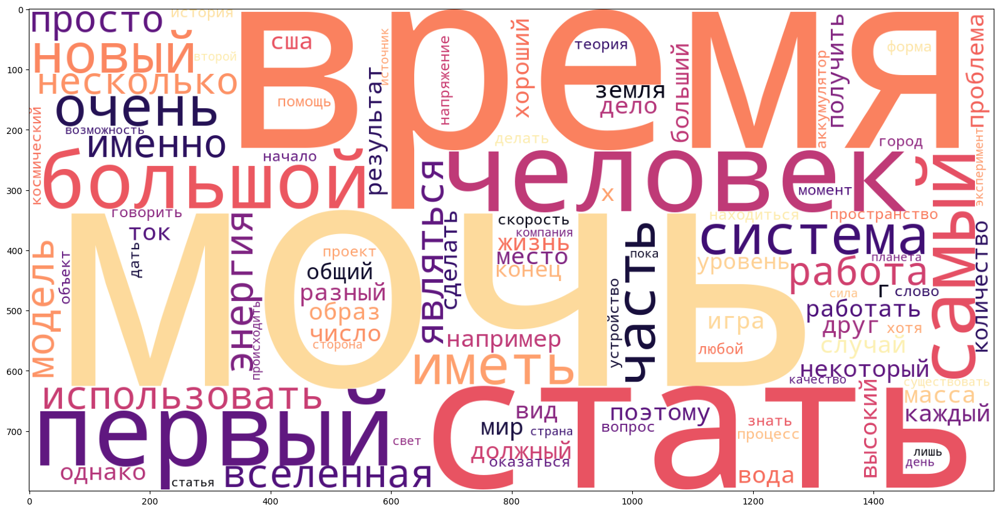

Theme: Блог компании ua-hosting.company
учёный мочь показать изображение время исследование результат использовать являться человек материал система высокий вода поверхность робот ddr каждый основа помощь использование клетка устройство метод v иметь большой скорость процесс получить однако среда изменение сигнал модель различный движение сервер dell ssd gbps сила образец сравнение значение уровень температура позволять слой x структура использоваться вид давление состояние объект больший частота выше f дать низкий область данные видео провести оставаться труд самый мм затем образ течение разный качество свойство размер увеличение первый энергия условие частица применение анализ эксперимент приводить форма напряжение количество несколько оценка ответ опыт случай ткань создать поскольку реакция r связь


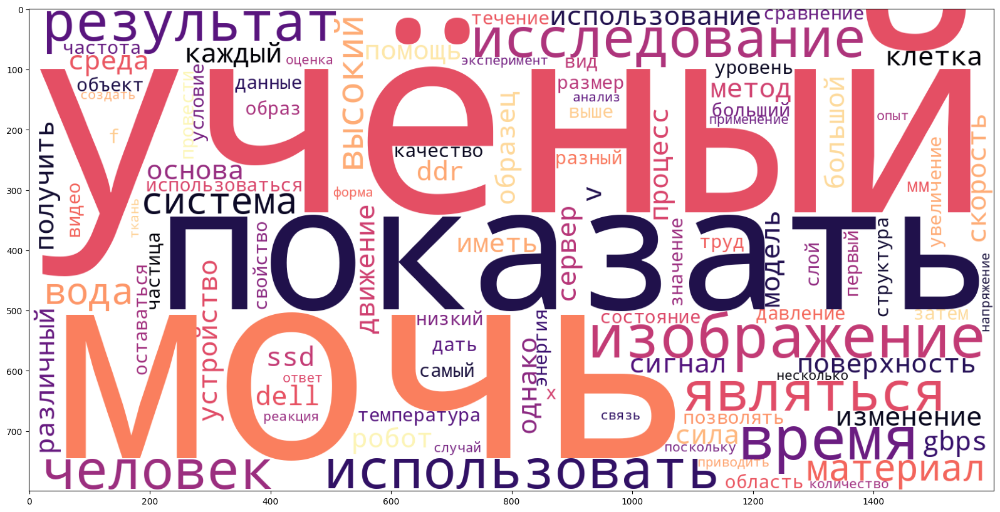

Theme: Блог компании FirstVDS
мочь первый время человек игра стать система большой работа новый компания использовать модель например самый несколько иметь работать мир технология часть каждый устройство очень проблема помощь однако получить сделать некоторый должный проект поэтому любой хороший больший момент космический просто позволять дело земля вид учёный результат скорость мозг место разный создать исследование кроме случай процесс дать объект друг нужно именно сша энергия информация машина аппарат использоваться уровень смочь количество сложный движение данные являться история делать х хотя программа задача говорить полёт высокий компьютер возможность двигатель игрок жизнь пока идея поверхность качество планета решение разработка простой появиться сигнал идти создание маленький около


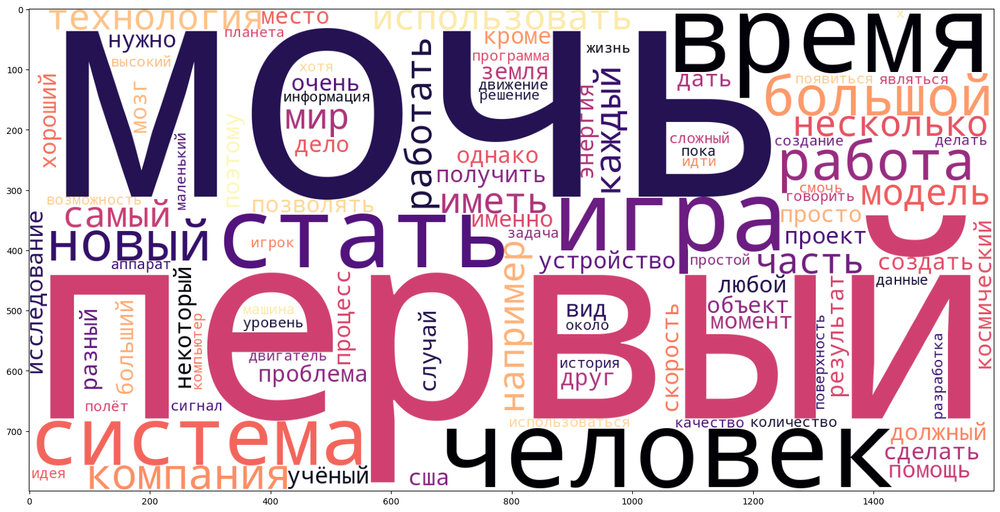

Theme: Читальный зал
мочь человек время мир первый новый стать часть система самый большой жизнь являться вопрос каждый вид работа очень хороший иметь должный книга просто процесс например именно говорить история некоторый наука мозг проблема статья век дать результат идея друг несколько больший исследование образ однако случай любой сделать растение существовать нужно сознание земля животное лишь дело делать место работать знать научный день учёный развитие получить сказать вселенная слово поэтому количество организм автор различный считать второй сторона пример общий форма теория хотя разный ваш маленький видеть момент тело начало решение компания связь давать использовать современный уровень машина сила находиться простой информация вода живой


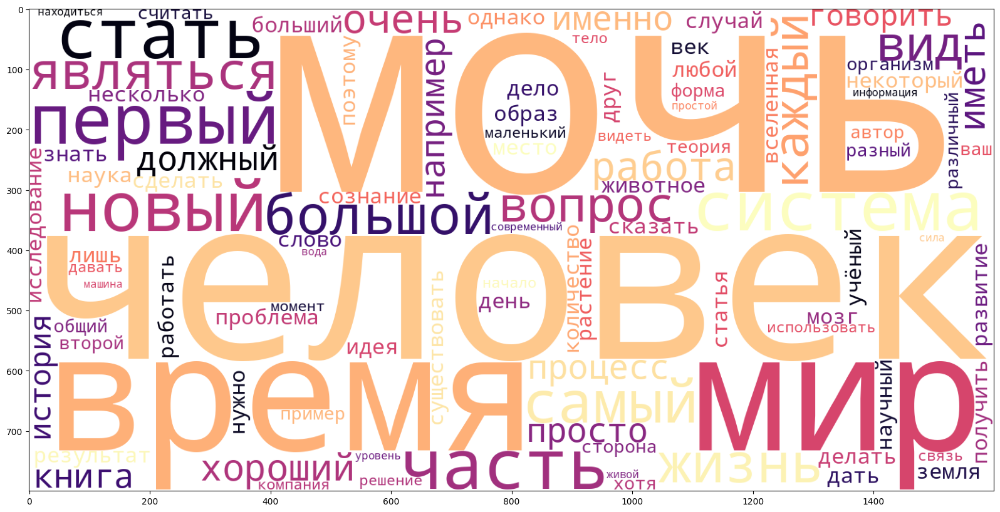

Theme: Блог компании Timeweb Cloud
мочь время первый человек система работа стать игра большой новый использовать самый очень иметь проект работать должный несколько часть больший каждый вид задача проблема ракета получить сделать язык являться например однако аппарат скорость дать мир данные компьютер машина место количество земля s просто некоторый случай решение программа создать помощь второй информация разный день вода именно хороший корабль космический сигнал орбита момент сторона правило компания поэтому история технология цель друг автомобиль сша клетка любой х результат км сеть исследование использоваться говорить пример энергия команда возможность позволять число интернет разработка начало сон простой дело жизнь r начать делать модель состояние маленький около


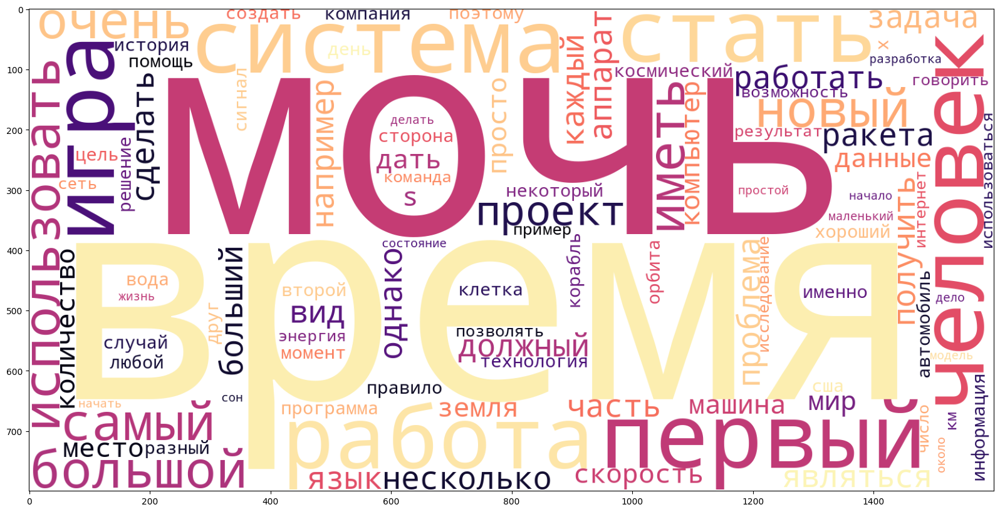

Theme: Математика*
число мочь система точка время теория математика являться иметь простой каждый математический значение большой человек функция первый пространство x информация квантовый любой состояние множество количество получить случай мир задача результат например очень вселенная образ угол модель часть p уравнение вид геометрия математик самый физика новый должный некоторый статья прямой друг физический смысл n вероятность говорить существовать элемент работа свойство использовать вопрос больший однако частица решение равный просто поэтому давать именно треугольник структура разный знать стать сказать симметрия форма закон дать процесс пример измерение энергия жизнь второй группа дело найти несколько общий кривая либо объект наука сложный сторона определение слово следующий


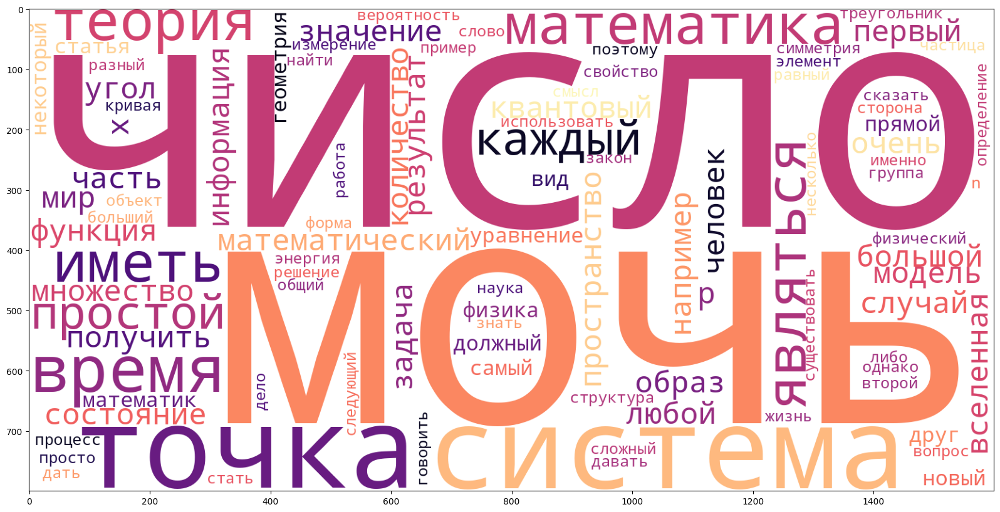

Theme: Блог компании Онлайн Патент
патент компания первый получить технология мочь стать время система изобретение новый заявка онлайн сша большой человек программа патентный страна например производство х мир интеллектуальный использовать собственность самый век база история решение промышленный работа создать данные число разработка знак вид область работать товарный американский устройство очень отечественный начало полезный услуга несколько управление машина литий помощь современный изобретатель дело рынок появиться учёный материал исследование инженер игра проблема информация способ университет сервис конец использование метод идея запатентовать алюминий иметь россия случай место институт вода цифровой лишь научный поиск реестр модель развитие высокий больший второй результат позволять регистрация право доллар писать говорить создавать каждый


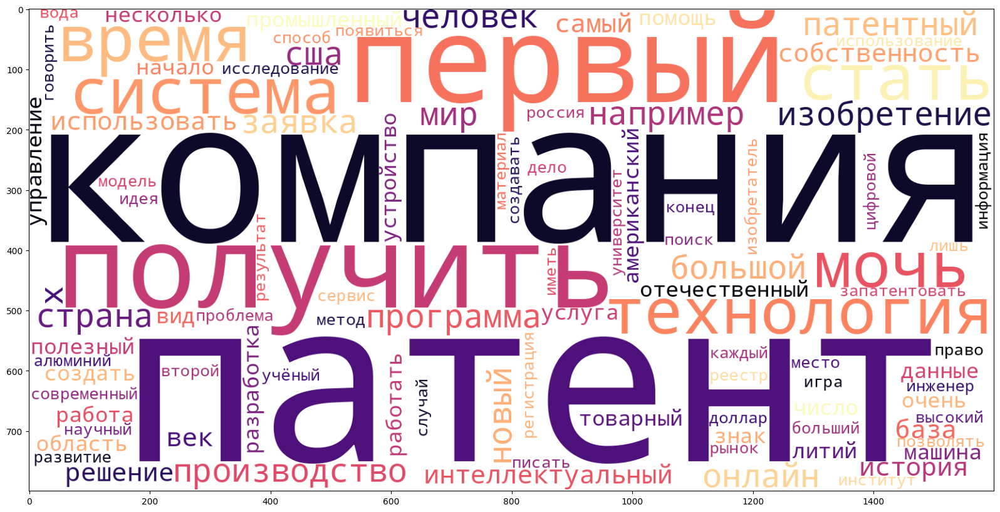

In [139]:
for i, tokens in freq_items.items():
    print('Theme:', i)
    draw_text_cloud(tokens)

In [166]:
# NOUN 	имя существительное 	хомяк

# ADJF 	имя прилагательное (полное) 	хороший
# ADJS 	имя прилагательное (краткое) 	хорош

# VERB 	глагол (личная форма) 	говорю, говорит, говорил
# INFN 	глагол (инфинитив) 	говорить, сказать

def get_part_of_speech(token):
    x = morph.parse(token)[0]
    tag = x.tag.POS
    
    if "ADJS" in x.tag:
        tag = 'ADJF'
    elif "INFN" in x.tag:
        tag = 'VERB'
    
    return tag

In [189]:
def get_freq(text):
    text = nltk.Text(text)
    return FreqDist(text)

In [195]:
freq_items = {}

for theme in themes:
    texts = ' '.join(df1[df1['theme'] == theme]['text'])
    text_tokens = word_tokenize(texts)
    text_tokens = [token.strip() for token in text_tokens if token not in stop_list]

    part_of_speech = {}
    for i in text_tokens:
        part = get_part_of_speech(i)
        
        if not part in part_of_speech:
            part_of_speech[part] = []
            
        part_of_speech[part].append(i)
    
    for key, value in part_of_speech.items():
        if key in ['NOUN', 'ADJF', 'VERB']:
            print(key)
            f = get_freq(value)
            freq_items[f'{theme}_{key}'] = [i[0] for i in f.most_common(100)]
    
            display_word_freq(theme, f)

NOUN
Научно-популярное
         Word  Amount
0        мочь   13857
1       время    7771
2     человек    6271
3      звезда    6268
4     система    5534
5     энергия    4162
6       земля    3683
7     планета    3668
8      работа    3447
9    скорость    3328
10  вселенная    3267
11      часть    3266
12        мир    3257
13  результат    3241
14    частица    3146
--------------------------------------------------------------------------- 



VERB
Научно-популярное
            Word  Amount
0          иметь    3604
1       являться    3541
2          стать    3211
3   использовать    2981
4       получить    2615
5     находиться    2575
6       говорить    2529
7   существовать    2278
8       работать    2261
9           дать    2182
10       сделать    2107
11    обнаружить    1919
12   происходить    1884
13         знать    1732
14       сказать    1728
--------------------------------------------------------------------------- 



ADJF
Научно-популярное
           Word  Am

Theme: Научно-популярное_NOUN
мочь время человек звезда система энергия земля планета работа скорость вселенная часть мир результат частица галактика исследование жизнь объект вода процесс масса друг случай вид свет теория состояние учёный количество проблема модель пространство волна точка вопрос мозг информация помощь уровень м место статья клетка солнце температура момент образ луна дыра расстояние материя день рис поверхность измерение сторона газ орбита эксперимент путь форма размер дело поле область телескоп движение материал двигатель сила тело число возможность группа конец условие слово физика начало наблюдение давление проект технология вещество история решение источник организм центр идея наука качество тип изменение пара спутник эффект автор метод


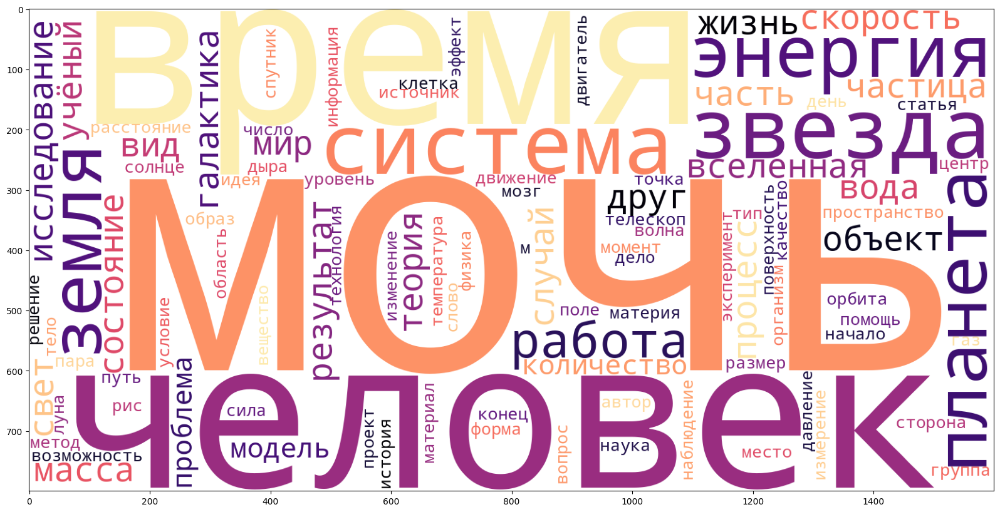

Theme: Научно-популярное_VERB
иметь являться стать использовать получить находиться говорить существовать работать дать сделать обнаружить происходить знать сказать делать позволять оказаться показать смочь давать называть смотреть считать составлять состоять видеть создать привести найти наблюдать начать оставаться представлять идти становиться увидеть двигаться использоваться представить возникать приводить связать понять казаться создавать расположить появиться хотеть позволить начинать обладать провести показывать жить произойти стоить получать проходить соответствовать выглядеть помочь определить зависеть опубликовать означать писать остаться образоваться решить пытаться удаться описать требовать пройти содержать понимать называться взять следовать разработать достигнуть считаться назвать построить отличаться думать получаться рассмотреть изучать влиять составить предполагать принять заметить предположить открыть вызвать объяснить меняться


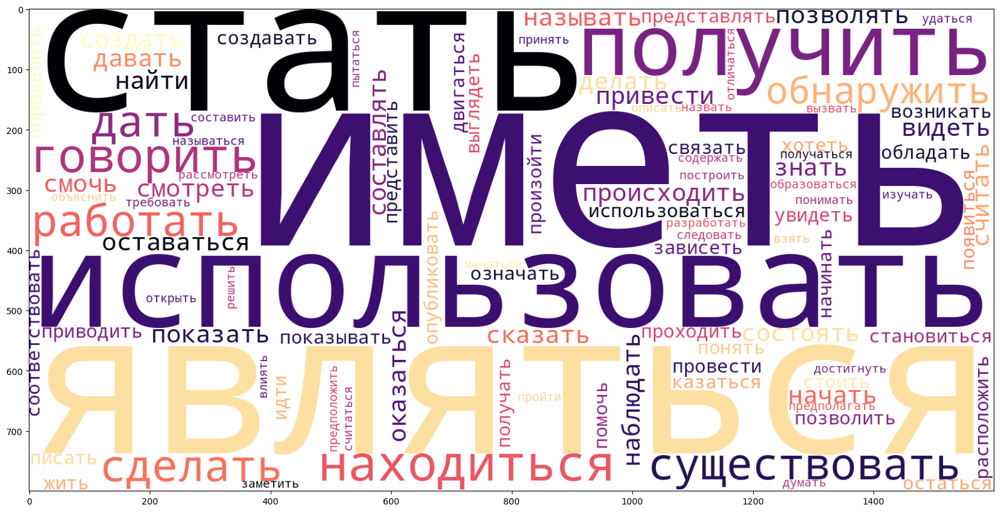

Theme: Научно-популярное_ADJF
большой первый новый самый должный квантовый больший каждый космический некоторый хороший чёрный высокий солнечный разный любой маленький общий научный второй известный сложный близкий тёмный различный важный звёздный последний простой следующий подобный небольшой гравитационный далёкий физический ранний современный полный возможный ваш огромный обычный крупный сильный интересный яркий отдельный способный данный определённый быстрый внутренний нужный настоящий красный внешний необходимый никакой постоянный человеческий реальный химический низкий основный электрический похожий собственный магнитный ядерный главный видимый иной средний световой окружающий многий дополнительный связанный искусственный волновой живой остальной лёгкий массивный классический слабый равный сверхновый полезный северный тяжёлый южный земной поздний единственный белый млечный немой естественный эффективный


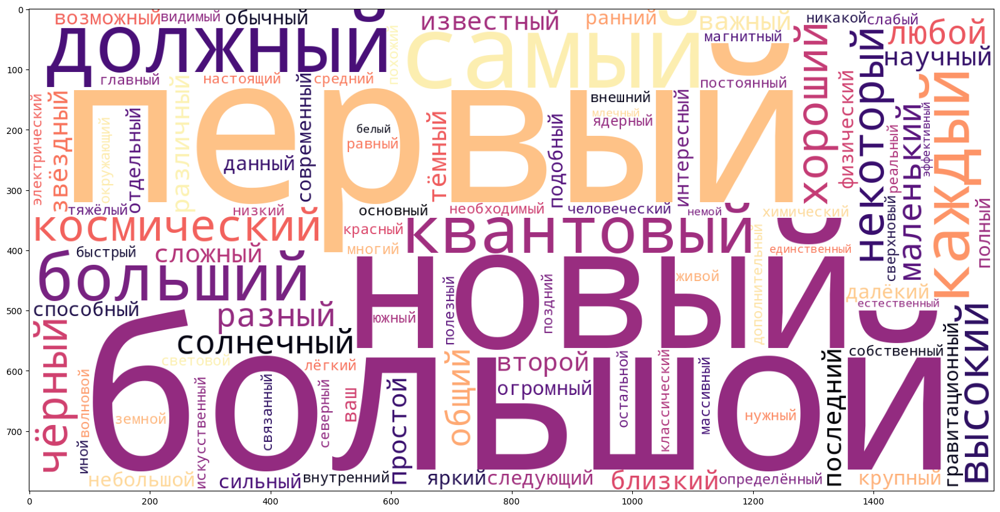

Theme: Блог компании RUVDS.com_NOUN
мочь время человек система часть работа вселенная энергия модель случай жизнь вид г результат дело ток число место мир масса проблема вода друг игра сша образ земля уровень количество конец пространство процесс начало форма момент объект напряжение теория слово проект устройство скорость история город помощь вопрос аккумулятор сила сторона день статья источник страна свет компания планета качество эксперимент возможность температура волна точка пример поле значение материя состояние идея сигнал м поверхность век технология развитие сеть создание размер центр частица материал исследование эффект учёный частота связь способ автор использование задача решение плотность основа программа область заряд движение интернет производство звезда акб


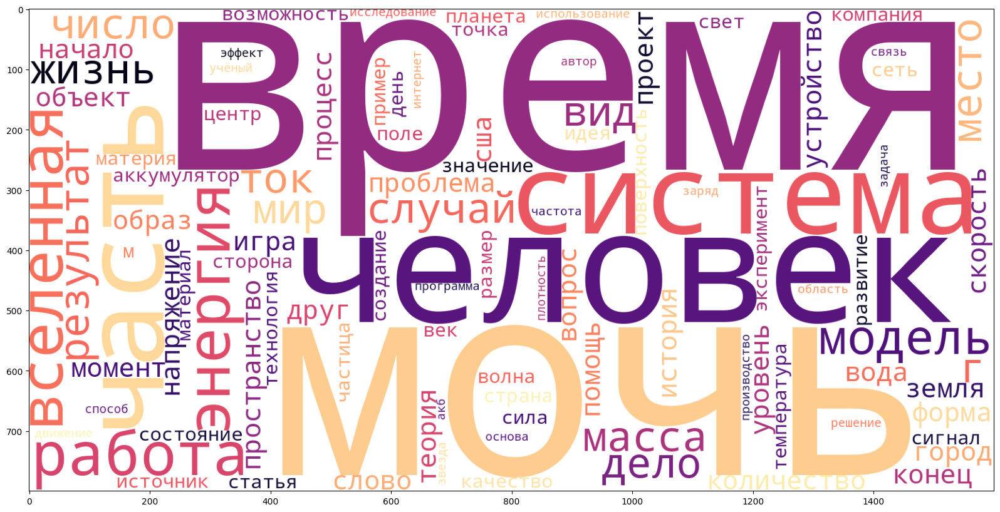

Theme: Блог компании RUVDS.com_VERB
стать иметь являться использовать работать получить сделать говорить находиться знать дать делать оказаться существовать происходить позволять видеть сказать начать использоваться найти появиться представлять давать создать показать хотеть называть идти выглядеть смочь составлять оставаться смотреть считать привести становиться решить начинать создавать остаться получать пытаться понять выйти состоять казаться получиться следовать стоить обнаружить наблюдать приводить представить расти назвать возникать жить увидеть начаться возникнуть нибыть взять прийтись требовать удаться соответствовать отличаться позволить зависеть заниматься писать принять описать продолжать получаться связать провести обладать двигаться думать появляться оказываться понимать написать вызывать произойти считаться построить требоваться означать называться посмотреть вести приходиться выходить показывать вызвать разработать пройти


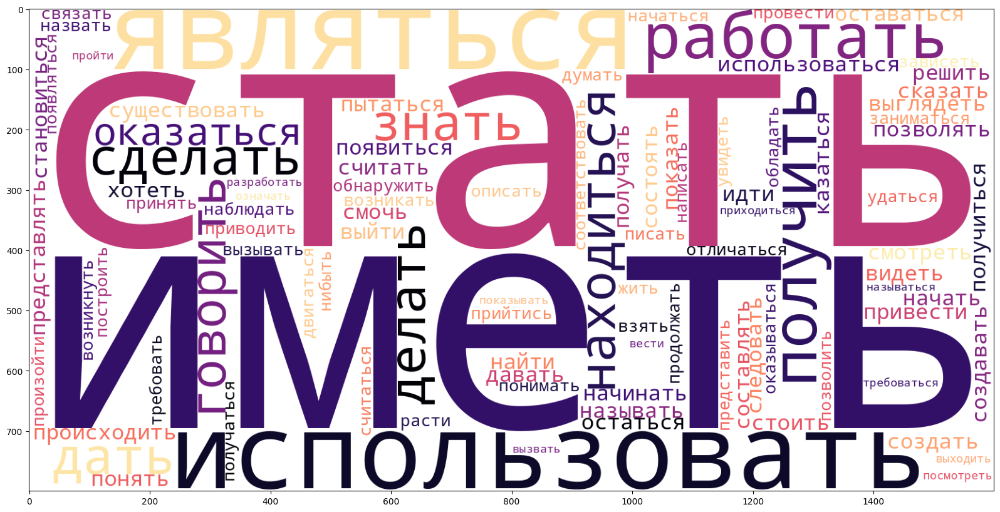

Theme: Блог компании RUVDS.com_ADJF
первый большой самый новый некоторый больший каждый должный разный хороший высокий общий любой космический второй маленький подобный известный современный следующий простой ядерный американский последний сложный далёкий чёрный важный ранний сей реальный крупный небольшой научный интересный квантовый различный обычный полный внутренний близкий настоящий отдельный многий собственный нужный военный тёмный советский солнечный главный огромный электрический определённый японский магнитный человеческий быстрый физический постоянный низкий красный мировой электронный сильный массовый технический популярный возможный иной социальный активный ваш живой китайский внешний классический способный поздний нулевой прямой химический специальный компьютерный старый основный южный средний остальной немой похожий древний русский дополнительный плохой третий тяжёлый целый предыдущий белый


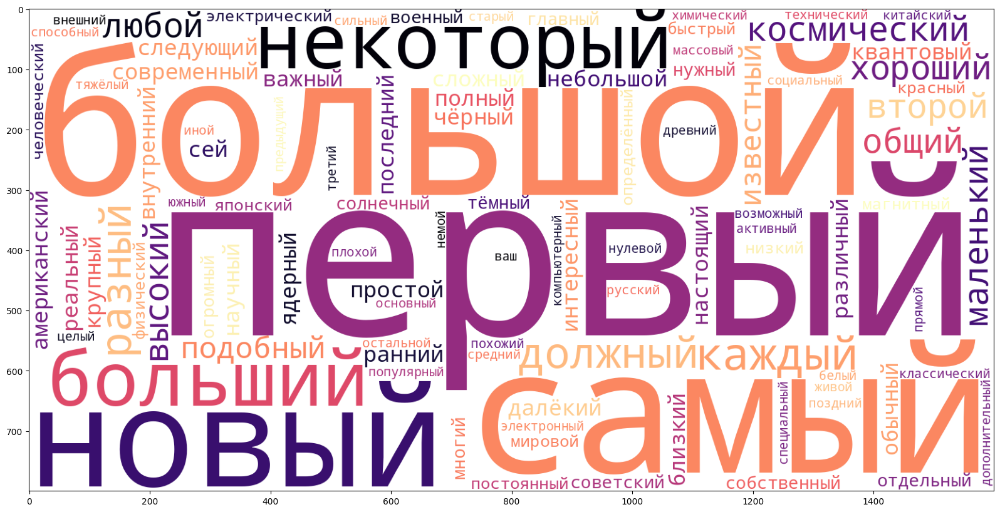

Theme: Блог компании ua-hosting.company_ADJF
высокий каждый большой различный больший низкий самый разный первый новый данный дополнительный уникальный важный общий сложный окружающий должный способный средний определённый химический мягкий эффективный доступный оптический солнечный хороший некоторый электрический значительный механический второй знакомый интересный внешний детальный любой основный подобный акустический небольшой максимальный дешёвый быстрый электронный связанный простой необходимый отдельный облачный сильный визуальный маленький постоянный магнитный полный внутренний активный испытуемый верхний временной исходный реальный искусственный физический синий прямой нейронный морской контрольный предыдущий аналогичный сенсорный иной обычный нижний относительный жидкий твёрдый клеточный стабильный динамический широкий современный выходной следующий обратный положительный точный биологический линейный экспериментальный трёхмерный гибкий дальнейший конечный поверхностный чистый

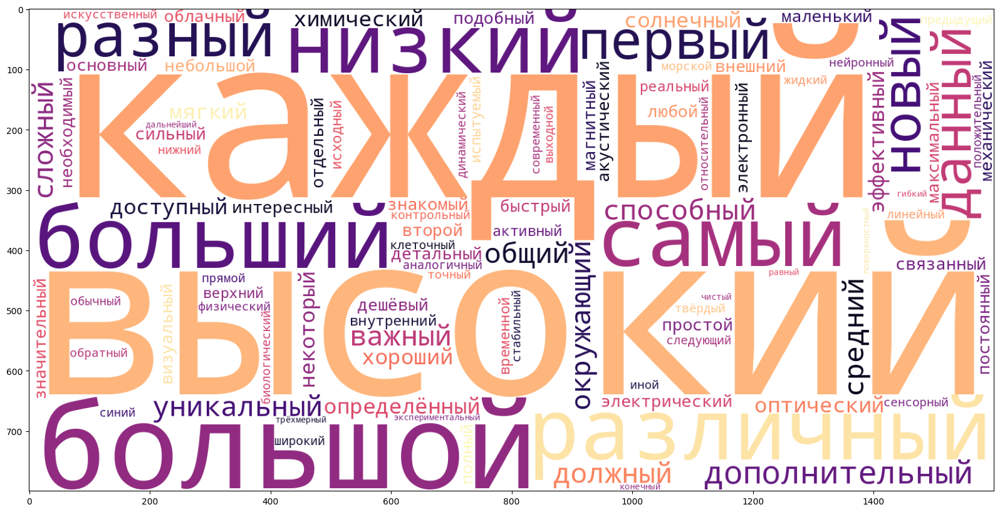

Theme: Блог компании ua-hosting.company_NOUN
учёный мочь изображение время исследование результат человек материал система вода поверхность робот основа помощь использование клетка устройство метод скорость процесс среда изменение сигнал модель движение сервер сила образец сравнение значение уровень температура слой структура вид давление состояние объект частота область видео труд образ течение качество свойство размер увеличение энергия условие частица применение анализ эксперимент форма напряжение количество оценка ответ опыт случай ткань реакция связь точка вариант свет группа доклад центр расстояние длина эффект работа день тип м направление тело вопрос крыло поле задача проблема часть деформация способность измерение диапазон волна линия информация пример масса датчик кожа электрод концентрация сторона создание


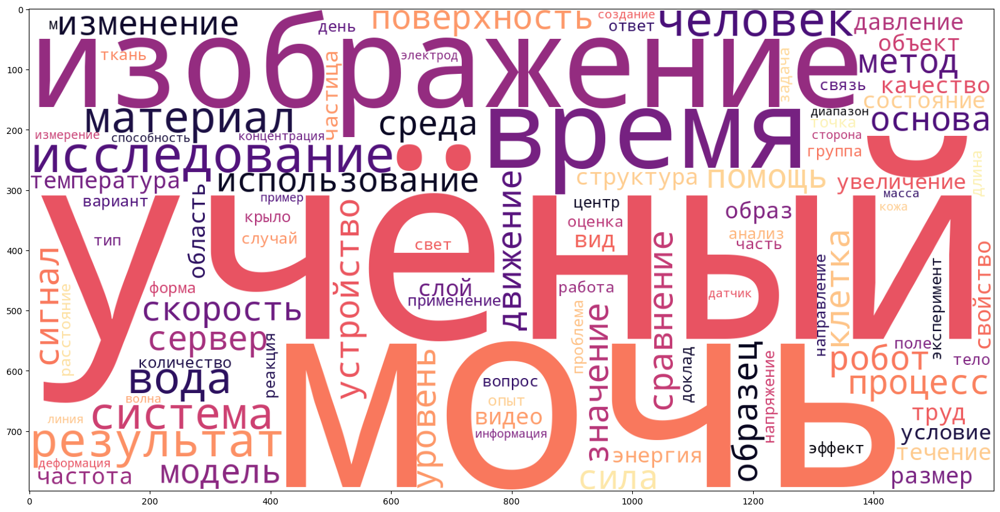

Theme: Блог компании ua-hosting.company_VERB
показать использовать являться иметь получить позволять использоваться дать провести оставаться приводить создать состоять наблюдаться демонстрировать показывать составлять смотреть разработать соответствовать обнаружить указывать содержать представлять обеспечивать обладать решить создавать связать найти построить происходить стать видеть продемонстрировать хотеть установить отмечать работать влиять рассмотреть учитывать привести говорить вызвать рассматривать увеличиваться исследовать определить представить сделать достигнуть зависеть оценить нравиться делить требовать находиться придумать рекомендовать заглянуть читать поддержать оформить проверить порекомендовать вызывать становиться измерить основать возникать отметить наблюдать стоить включать подтвердить составить давать существовать генерировать определять выбрать следовать достигать позволить изучить заключаться делать способствовать предполагать проводиться контролировать образоват

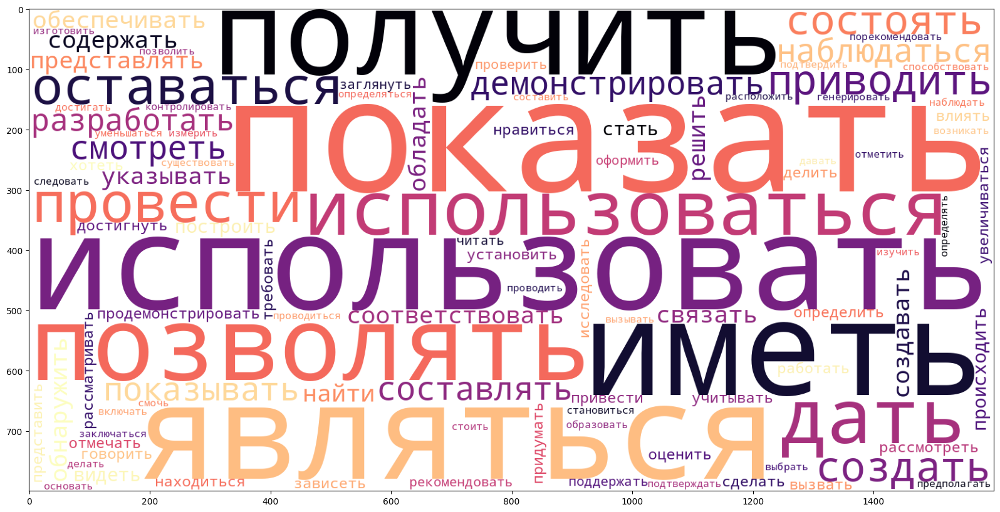

Theme: Блог компании FirstVDS_NOUN
мочь время человек игра система работа компания модель мир технология часть устройство проблема помощь проект момент дело земля вид учёный результат скорость мозг место исследование случай процесс объект друг сша энергия информация машина аппарат уровень количество движение история программа задача полёт компьютер возможность двигатель игрок жизнь идея поверхность качество планета решение разработка сигнал создание рука использование производство изображение конец начало материал метод область день точка число свет самолёт основа фильм тариф робот сторона автомобиль сила ток станция вариант эффект вопрос корабль размер тело луна телескоп доллар статья название эксперимент элемент тысяча связь пример страна конструкция развитие космос спутник кость образ


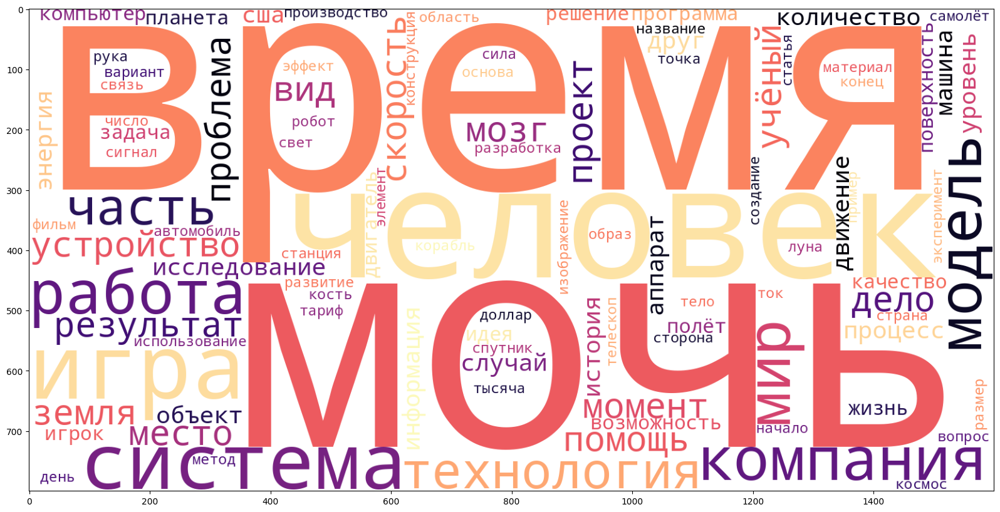

Theme: Блог компании FirstVDS_ADJF
первый большой новый самый каждый некоторый должный любой хороший больший космический разный сложный высокий простой маленький второй современный далёкий нужный важный солнечный общий электрический огромный научный последний небольшой следующий специальный реальный настоящий главный крупный известный подобный обычный американский близкий способный различный ваш отдельный поздний собственный быстрый компьютерный похожий чёрный электронный дополнительный искусственный ранний советский определённый полный низкий тёмный интересный технический постоянный основный мировой человеческий доступный никакой цифровой лёгкий открытый магнитный мощный сей многий готовый красный китайский игровой внешний военный сильный популярный немой третий воздушный живой необходимый возможный очевидный полезный переменный механический серьёзный технологический долгий лунный паровой массовый прямой данный успешный


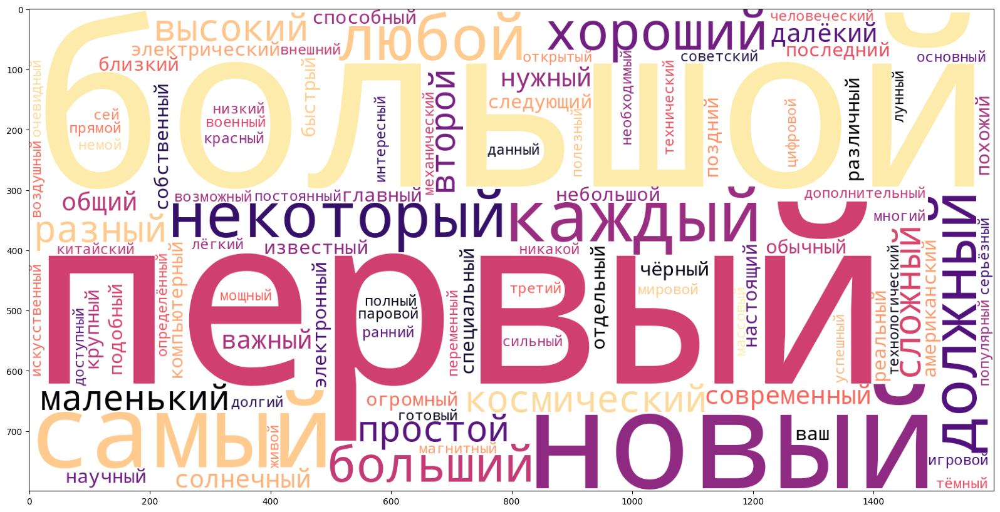

Theme: Блог компании FirstVDS_VERB
стать использовать иметь работать получить сделать позволять создать дать использоваться смочь являться делать говорить появиться идти решить знать находиться найти существовать создавать выглядеть разработать оставаться оказаться показать происходить давать стоить прийтись оставить называть получать начать привести состоять видеть хотеть увидеть составлять считать представлять сказать позволить представить прилететь заниматься выйти казаться смотреть посмотреть построить удаться начинать становиться летать помогать пытаться расположить остаться провести проходить взять получиться помочь пройти обнаружить суть предложить требовать назвать приходиться запустить произойти появляться показывать продолжать приводить понять думать требоваться достигнуть двигаться выполнять отличаться содержать наблюдать основать придумать установить проводить обеспечивать получаться начаться предлагать жить добавить понимать открыть


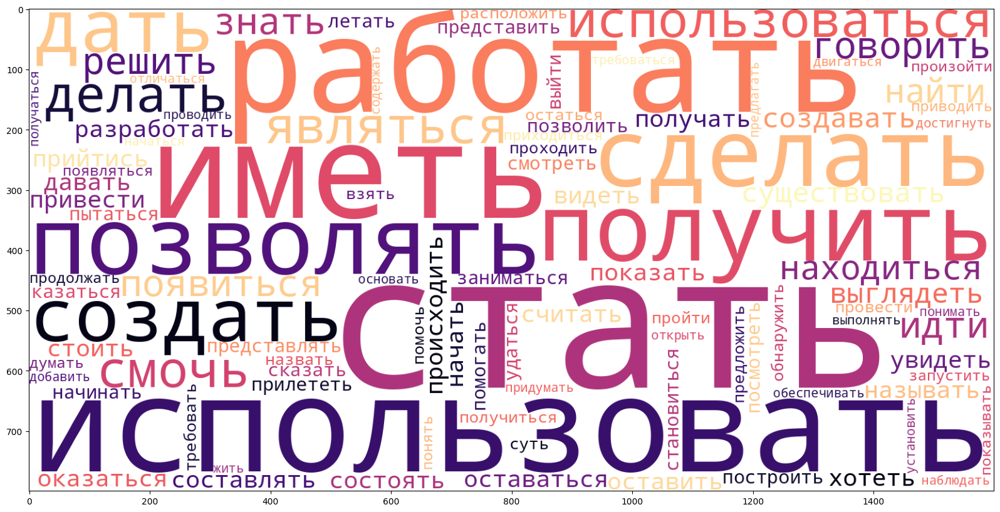

Theme: Читальный зал_ADJF
первый новый самый большой каждый хороший должный некоторый больший любой научный различный второй общий разный ваш маленький современный простой живой сложный важный высокий последний огромный следующий подобный никакой человеческий известный настоящий далёкий определённый иной собственный нужный способный главный крупный отдельный полный внешний физический космический ранний некий интересный сильный небольшой древний естественный плохой возможный единственный близкий поздний внутренний основный американский красный данный немой многий великий чёрный остальной целый мировой обратный обычный очевидный военный реальный технический квантовый искусственный окружающий быстрый долгий готовый средний связанный частый лёгкий третий правильный единый социальный основной похожий римский специальный полезный конкретный необходимый широкий гравитационный советский субъективный солнечный


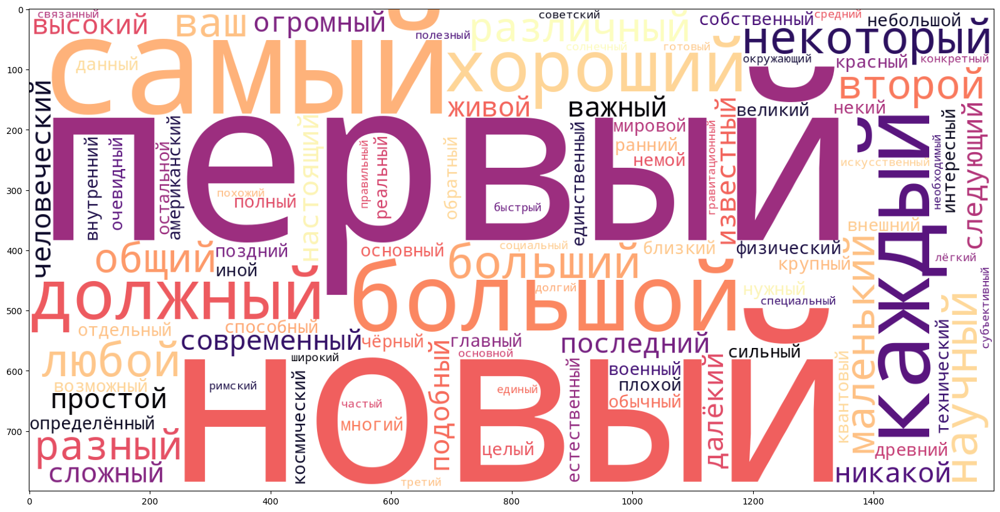

Theme: Читальный зал_NOUN
мочь человек время мир часть система жизнь вопрос вид работа книга процесс история наука мозг проблема статья век результат идея друг исследование образ случай растение сознание земля животное дело место день учёный развитие вселенная слово количество организм автор сторона пример форма теория момент тело начало решение компания связь уровень машина сила информация вода смысл страна группа число задача ребёнок точка планета качество причина конец материал знание структура условие реальность возможность ответ свет правило метод помощь война опыт корабль клетка пространство изменение голова план цель принцип проект основа тысяча способ рост вывод труд путь состояние мысль факт природа период зрение бог


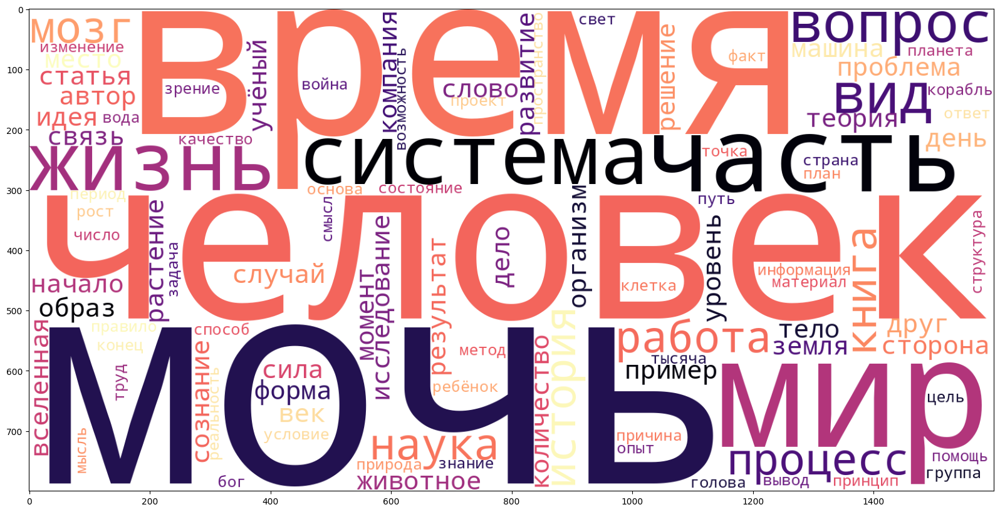

Theme: Читальный зал_VERB
стать являться иметь говорить дать сделать существовать делать работать знать получить сказать считать видеть давать использовать находиться происходить оказаться идти жить найти казаться писать называть начать хотеть смочь стоить думать становиться понимать создать понять привести позволять появиться пытаться начинать смотреть решить оставаться взять представить приводить получать обладать состоять связать показать соответствовать заниматься увидеть создавать представлять выйти написать возникать принять обнаружить посмотреть остаться описать играть составлять изучать назвать рассматривать произойти описывать следовать выглядеть прийти читать прийтись расти пройти требовать позволить построить получаться отличаться считаться утверждать поставить показывать продолжать помнить использоваться провести означать содержать принимать называться пойти суть род проходить лежать отвечать


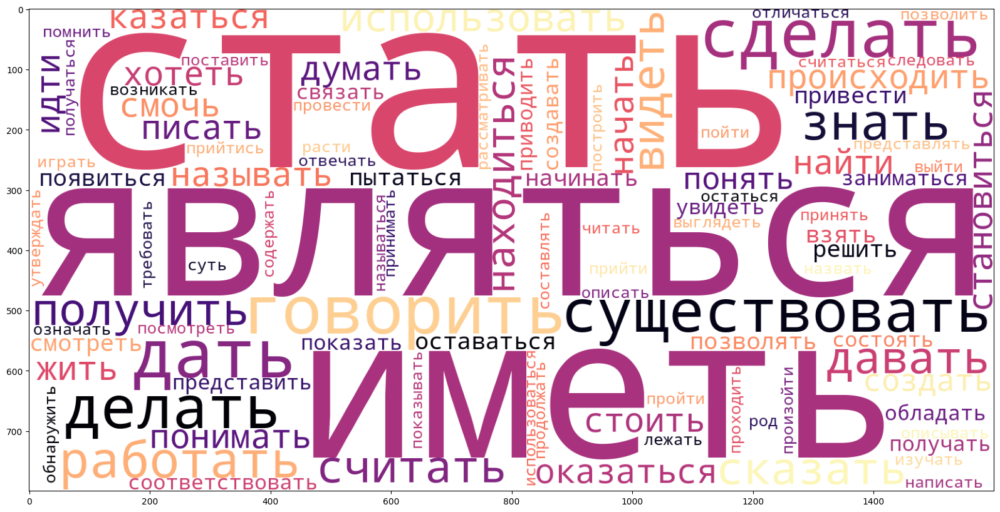

Theme: Блог компании Timeweb Cloud_NOUN
мочь время человек система работа игра проект часть вид задача проблема ракета язык аппарат скорость мир компьютер машина место количество земля случай решение программа помощь информация день вода корабль сигнал орбита момент сторона правило компания история технология цель друг автомобиль сша клетка результат км сеть исследование пример энергия команда возможность число интернет разработка начало сон дело жизнь модель состояние вариант самолёт двигатель процесс м слово звук создание радар фильм вопрос полёт идея страна управление конец метод образ использование уровень частота статья связь качество точка мощность спутник материал источник учёный размер название рабочий канал группа час станция основа устройство фото поверхность


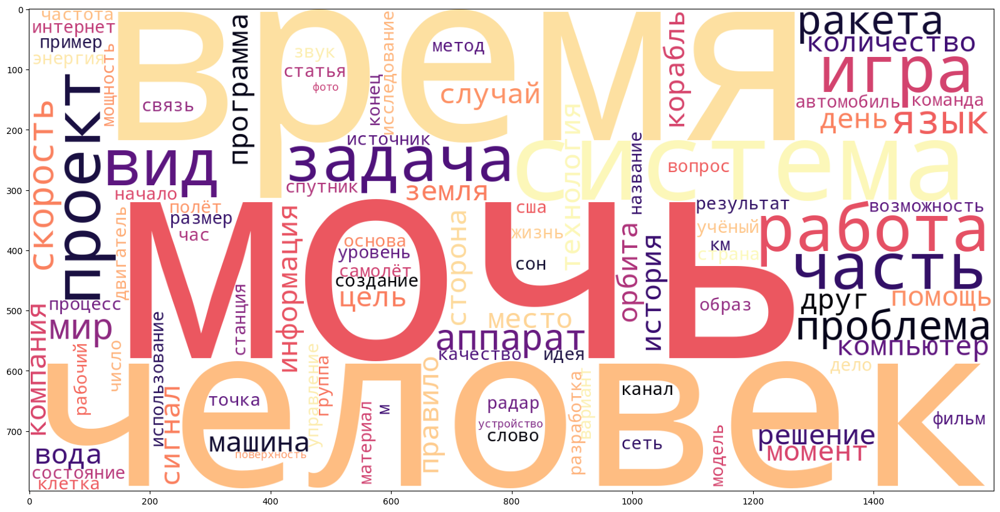

Theme: Блог компании Timeweb Cloud_VERB
стать использовать иметь работать получить сделать являться дать создать использоваться говорить позволять начать делать знать оказаться смочь находиться существовать найти давать стоить решить происходить идти смотреть разработать создавать появиться называть видеть построить сказать считать получать показать привести хотеть прийтись составлять представлять состоять выйти взять принять представить заниматься выглядеть требовать получиться увидеть пройти казаться остаться провести связать становиться позволить начинать назвать понять проводить проходить начаться написать произойти писать понимать обнаружить оставаться посмотреть выполнять требоваться показывать играть называться пытаться включать выбрать предложить установить вернуться помочь означать отметить изменить удаться вызвать появляться запустить приводить зависеть узнать помогать поставить влиять обладать содержать продолжать рассмотреть


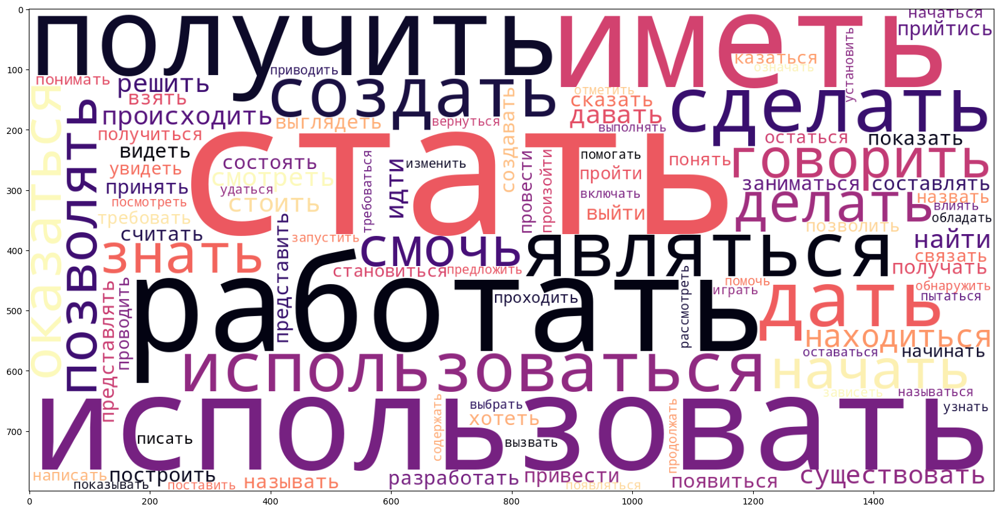

Theme: Блог компании Timeweb Cloud_ADJF
первый большой новый самый должный больший каждый некоторый второй разный хороший космический любой простой маленький советский общий высокий различный известный последний сложный следующий научный небольшой современный крупный быстрый важный подобный технический солнечный обычный интересный огромный поздний военный нужный полный американский главный собственный определённый отдельный внутренний способный реальный настоящий ранний данный необходимый близкий компьютерный ваш похожий живой программный возможный низкий сильный третий далёкий основный внешний ядерный электронный дополнительный популярный доступный искусственный мощный центральный прямой постоянный открытый никакой серьёзный специальный орбитальный долгий целый частый электрический мировой северный магнитный единственный русский многий основной широкий человеческий лёгкий вычислительный активный немой молодой тяжёлый чёрный европейский


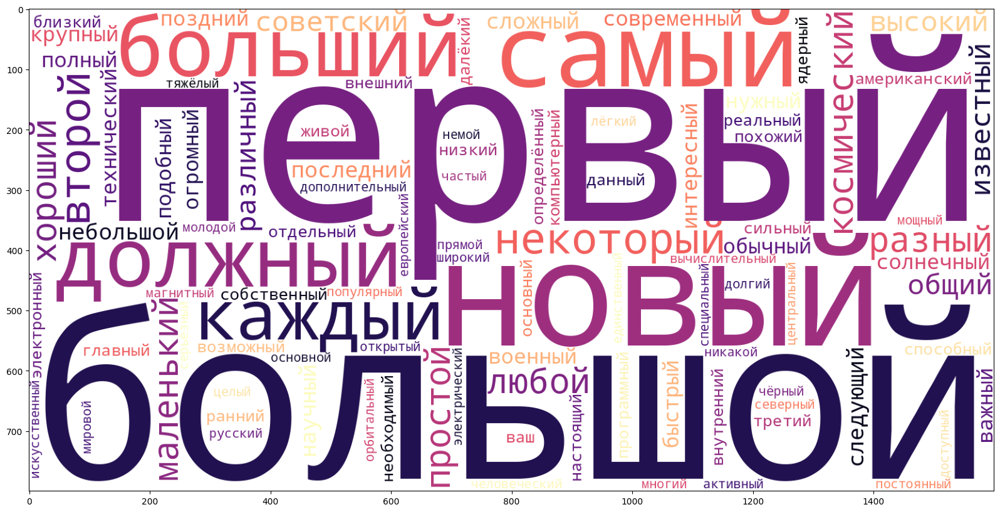

Theme: Математика*_NOUN
число мочь система точка время теория математика значение человек функция пространство информация состояние множество количество случай мир задача результат вселенная образ угол модель часть уравнение вид геометрия математик физика статья друг смысл вероятность элемент работа свойство вопрос частица решение треугольник структура симметрия форма закон процесс пример измерение энергия жизнь группа дело кривая объект наука сторона определение слово поле единица область понятие энтропия идея вектор помощь величина преобразование проблема формула линия скорость метод механика уровень язык степень теорема порядок момент книга окружность ось отношение параметр масса расстояние мера способ сумма коэффициент сложность место учебник начало основа движение принцип последовательность исследование плоскость


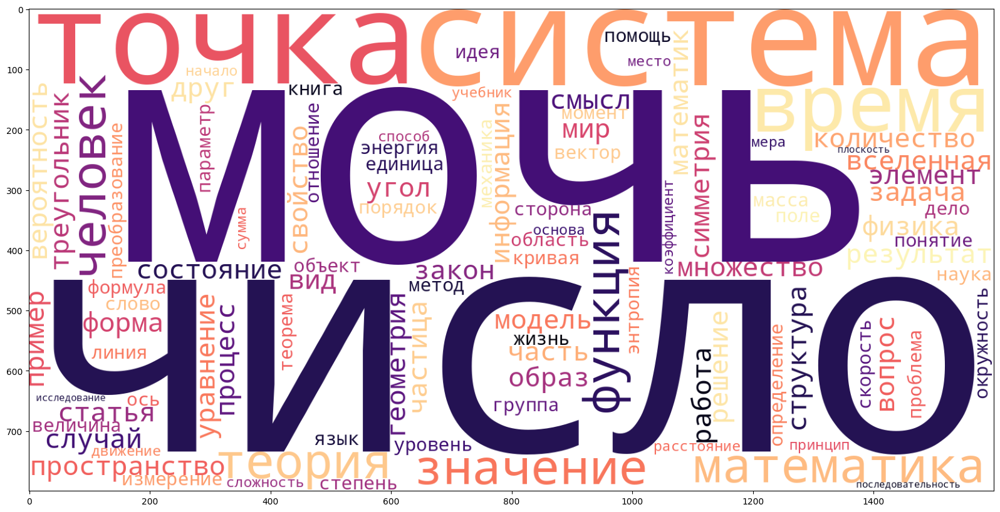

Theme: Математика*_ADJF
простой каждый математический большой первый квантовый любой самый новый должный некоторый прямой физический больший равный разный второй общий сложный следующий маленький хороший известный классический возможный геометрический фундаментальный бесконечный определённый различный случайный элементарный интересный высокий постоянный целый конечный последний полный данный обратный никакой алгебраический отдельный важный средний научный очевидный вещественный волновой чёрный иной магнитный современный естественный подобный необходимый единственный начальный точный близкий далёкий реальный третий похожий предыдущий битый истинный собственный комплексный одинаковый школьный рациональный небольшой поздний настоящий многий ваш внешний адический основный главный вычислительный остальной переменный логический обычный произвольный немой числовой правильный конкретный полезный некий абстрактный связанный исходный тонкий красный великий


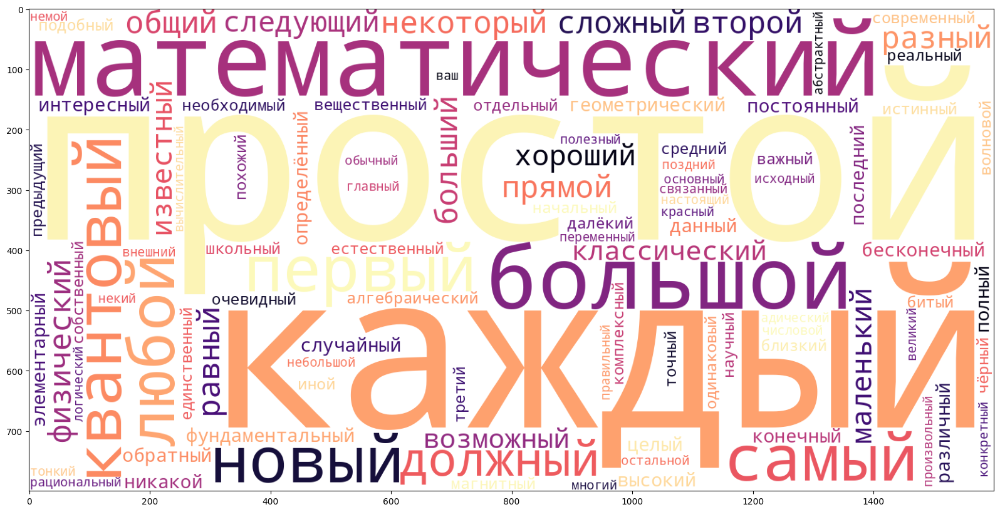

Theme: Математика*_VERB
являться иметь получить говорить существовать использовать давать знать стать сказать дать найти называть работать считать понять находиться показать доказать сделать оказаться представить получать происходить состоять соответствовать видеть делать позволять образовать взять хотеть привести следовать смочь казаться построить связать называться выглядеть становиться описывать определить представлять возникать зависеть решить создать оставаться рассмотреть обладать идти написать получиться обнаружить получаться означать писать увидеть рассматривать приводить изучать провести начать начинать думать смотреть понимать описать использоваться назвать узнать содержать выбрать пытаться оказываться лежать вычислить составлять требовать принять заметить отличаться остаться ожидать наблюдать задать считаться создавать заключаться определять расти появляться нибыть разделить учитывать вернуться предложить жить открыть


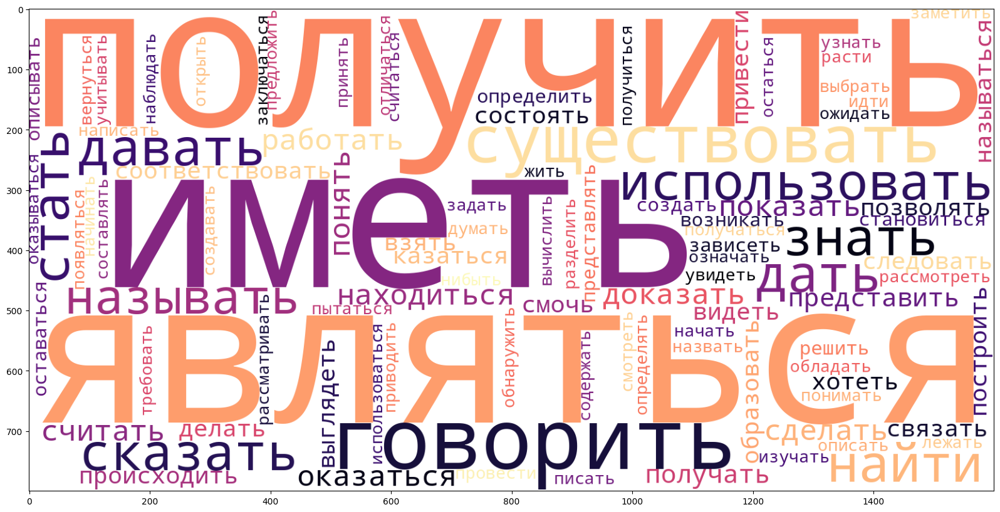

Theme: Блог компании Онлайн Патент_NOUN
патент компания технология мочь время система изобретение заявка сша человек программа страна производство мир собственность век база история решение работа число разработка знак вид область устройство начало услуга управление машина литий помощь изобретатель дело рынок учёный материал исследование инженер игра проблема информация способ университет сервис конец использование метод идея алюминий россия случай место институт вода поиск реестр модель развитие результат регистрация право доллар создание автор жизнь процесс специалист защита источник книга сфера слово карта двигатель наука бизнес предприятие фирма часть возможность основа млн свет точка компьютер корпорация война доступ количество роспатент штат проект скорость качество металл эксперт связь рф поддержка


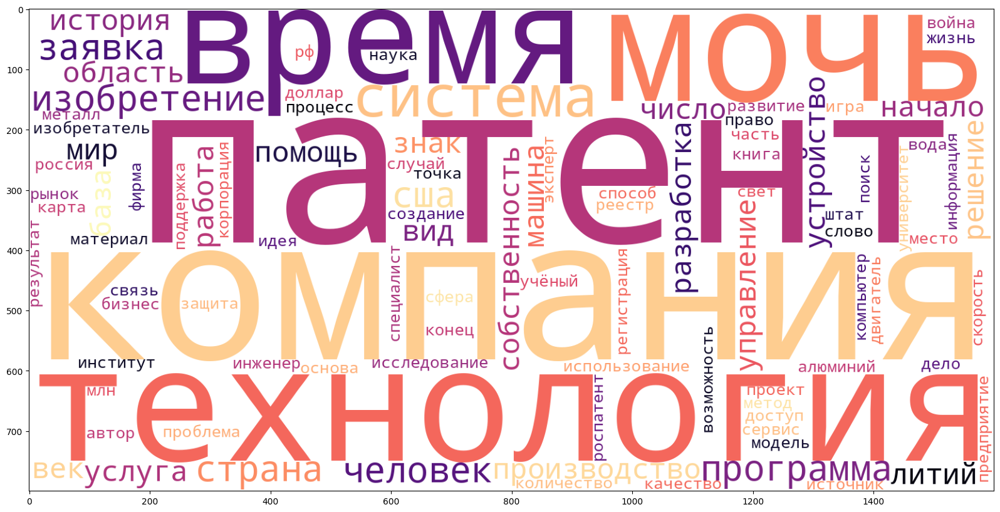

Theme: Блог компании Онлайн Патент_VERB
получить стать использовать создать работать появиться запатентовать иметь позволять писать говорить создавать сделать называть являться сказать использоваться подать решить дать разработать искать стоить получать идти изобрести начать делать закрепить заниматься считать зарегистрироваться начаться знать производить составлять описать построить оказаться оставаться существовать найти смочь выйти основать состоять назвать касаться написать привести опубликовать приводить требовать попасть находиться позволить представить остаться начинать описывать продолжать рассказать запустить принадлежать рассказывать защитить считаться расти представлять удаться придумать показать давать достигнуть помочь прийтись приходиться выдать становиться обеспечивать заявить прийти действовать занимать выпустить включать произойти выделить пойти составить относиться зарегистрировать разрабатывать сохранить называться казаться отличаться провести пытаться увидеть


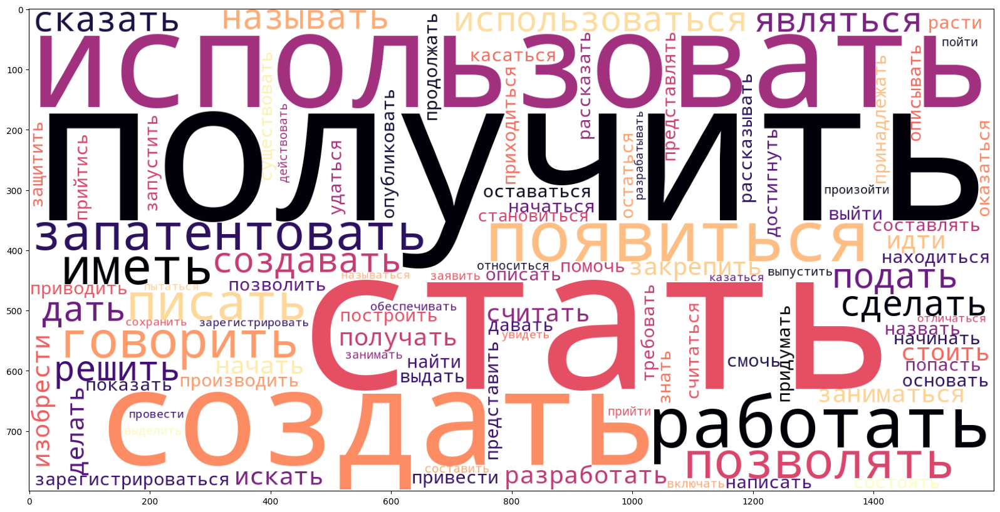

Theme: Блог компании Онлайн Патент_ADJF
первый новый большой патентный интеллектуальный самый промышленный товарный американский отечественный полезный современный цифровой научный высокий больший второй каждый следующий последний квантовый должный разный японский известный мировой бесплатный крупный собственный любой уникальный космический простой некоторый сложный технический государственный главный подробный игровой технологический иной искусственный ускоренный общий экономический химический компьютерный поздний военный ранний маленький огромный похожий электрический хороший советский нужный основный способный небольшой судебный сей реальный российский важный немой механический оптический подобный электронный солнечный связанный успешный обычный различный доступный интересный чистый медицинский авторский отдельный многий внутренний ключевой водородный основное коммерческий исследовательский железный национальный настоящий прямой нулевой массовый частный полный жидкий третий популярн

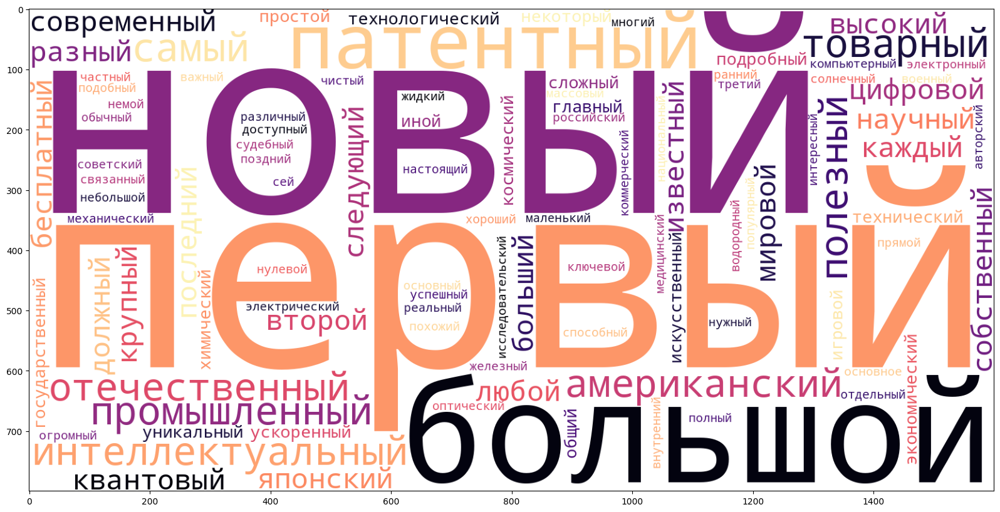

In [196]:
for i, tokens in freq_items.items():
    print('Theme:', i)
    draw_text_cloud(tokens)